# First Individual Project Assignment:-
- NAME: KISAKYE BARBRA
- REGNO:2022/HD07/1966U
- STUDENT NO:2200701966 

You are a lead data scientist on a project regarding maternal health, you are provided with a dataset regarding featal health. (Please find the dataset in the data folder given). These are your instructions
1 - Use that dataset to do: EDA, Clean the data
2 - Use mandas Profiling to export a pdf report of your data (explain how the report informs your future decisions)
3 - Apply any needed transformations if possible.
4 - Choose a proper evaluation metric for your project.
5 - Do model spot checking to find the best model for your use.
6 - Build the chosen model
7 - Evaluate bias vs variance on your model and present your results.

Note:
- Please follow instructions!
- You have to explain in detail every step you are executing in your own words, your result will be based on how well you explain what steps you are executing.
- Students are allowed to use public resources off the internet for their research, however students are not allowed to copy and paste code for this assignment (If you are caught, you will fail this assignment, you have been warned: especially chatGpt.)
- This is a graded individual assignment any malpractice will lead to losing of points, this assignment contributes a great percentage to your final grade.
- All assignments must be handed in by Close of Business next Wednesday by 6:00PM Date: 3rd - May - 2023
- All your assignments will be handed in by means of a pull request to my original repository.
- Please name your pull requests as per previously instructed, you will not get warnings for failing to do this.
- Your work should be saved in the Project Folder (Create your own folder and give the folder your name.)


In [25]:
# Importing required libraries
import pandas as pd # For the manipulation of tabular data
import numpy as np # For improved numerical calculation
from ydata_profiling import ProfileReport # For exploratory data analysis reporting
import matplotlib.pyplot as plt # For plotting
import seaborn as sns # For improved plot outlook

%matplotlib inline 

# Importing the scaler
from sklearn.preprocessing import StandardScaler

# Importing required models and metrics
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score
from sklearn.dummy import DummyClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier

# removing the warnings from the cells.
import warnings
warnings.filterwarnings('ignore')

### Task 1

Here we loaded our data from the Data folder named feta_health.csv

#### Reading the Data

In [8]:
# Loading the fetal health data
data = pd.read_csv(r"D:\Bigbio Data\big-bio-data-class-2023\Data\Featal Health Classification\fetal_health.csv")

In [9]:
print(data)

      baseline value  accelerations  fetal_movement  uterine_contractions  \
0              120.0          0.000           0.000                 0.000   
1              132.0          0.006           0.000                 0.006   
2              133.0          0.003           0.000                 0.008   
3              134.0          0.003           0.000                 0.008   
4              132.0          0.007           0.000                 0.008   
...              ...            ...             ...                   ...   
2121           140.0          0.000           0.000                 0.007   
2122           140.0          0.001           0.000                 0.007   
2123           140.0          0.001           0.000                 0.007   
2124           140.0          0.001           0.000                 0.006   
2125           142.0          0.002           0.002                 0.008   

      light_decelerations  severe_decelerations  prolongued_decelerations  

#### Exploratory Data Analysis (EDA)
Exploratory Data Analysis (EDA) is an important step in machine learning that involves examining and analyzing data to understand its underlying patterns and relationships. EDA is a crucial component of the data pre-processing stage, as it helps in identifying data quality issues, missing values, and outliers that can affect the accuracy of the machine learning model.

I went ahead and checked the shape of the data

In [10]:
# Checking the shape of the data
data.shape

(2126, 22)

In [8]:
# Displaying the first five rows of the data
data.head()

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
0,120.0,0.000,0.0,0.000,0.000,0.0,0.0,73.0,0.5,43.0,...,62.0,126.0,2.0,0.0,120.0,137.0,121.0,73.0,1.0,2.0
1,132.0,0.006,0.0,0.006,0.003,0.0,0.0,17.0,2.1,0.0,...,68.0,198.0,6.0,1.0,141.0,136.0,140.0,12.0,0.0,1.0
2,133.0,0.003,0.0,0.008,0.003,0.0,0.0,16.0,2.1,0.0,...,68.0,198.0,5.0,1.0,141.0,135.0,138.0,13.0,0.0,1.0
3,134.0,0.003,0.0,0.008,0.003,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,11.0,0.0,137.0,134.0,137.0,13.0,1.0,1.0
4,132.0,0.007,0.0,0.008,0.000,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,9.0,0.0,137.0,136.0,138.0,11.0,1.0,1.0


### I went ahead and checked for missing values and the results below indicate that there are no missing values in the dataset

In [11]:
# Checking for number presence of null values and dtypes
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2126 entries, 0 to 2125
Data columns (total 22 columns):
 #   Column                                                  Non-Null Count  Dtype  
---  ------                                                  --------------  -----  
 0   baseline value                                          2126 non-null   float64
 1   accelerations                                           2126 non-null   float64
 2   fetal_movement                                          2126 non-null   float64
 3   uterine_contractions                                    2126 non-null   float64
 4   light_decelerations                                     2126 non-null   float64
 5   severe_decelerations                                    2126 non-null   float64
 6   prolongued_decelerations                                2126 non-null   float64
 7   abnormal_short_term_variability                         2126 non-null   float64
 8   mean_value_of_short_term_variability  

 I went ahead and displayed the descriptive statistics of a dataset

In [12]:
# Displaying the data's descriptive statistics
data.describe().T

,count,mean,std,min,25%,50%,75%,max
baseline value,2126.0,133.303857,9.840844,106.0,126.000,133.000,140.000,160.000
accelerations,2126.0,0.003178,0.003866,0.0,0.000,0.002,0.006,0.019
fetal_movement,2126.0,0.009481,0.046666,0.0,0.000,0.000,0.003,0.481
uterine_contractions,2126.0,0.004366,0.002946,0.0,0.002,0.004,0.007,0.015
light_decelerations,2126.0,0.001889,0.002960,0.0,0.000,0.000,0.003,0.015
severe_decelerations,2126.0,0.000003,0.000057,0.0,0.000,0.000,0.000,0.001
prolongued_decelerations,2126.0,0.000159,0.000590,0.0,0.000,0.000,0.000,0.005
abnormal_short_term_variability,2126.0,46.990122,17.192814,12.0,32.000,49.000,61.000,87.000
mean_value_of_short_term_variability,2126.0,1.332785,0.883241,0.2,0.700,1.200,1.700,7.000
percentage_of_time_with_abnormal_long_term_variability,2126.0,9.846660,18.396880,0.0,0.000,0.000,11.000,91.000


### Checked for duplicates in the data set using the fuction data[data.duplicated()] and the results indicated that they were duplicates

In [13]:
# Checking for duplicates
data[data.duplicated()]

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
68,140.0,0.007,0.000,0.004,0.0,0.0,0.0,34.0,1.2,0.0,...,119.0,179.0,2.0,0.0,156.0,153.0,155.0,5.0,0.0,1.0
234,123.0,0.000,0.000,0.000,0.0,0.0,0.0,49.0,0.8,7.0,...,63.0,137.0,2.0,0.0,129.0,127.0,129.0,2.0,1.0,1.0
306,145.0,0.000,0.020,0.000,0.0,0.0,0.0,77.0,0.2,45.0,...,129.0,150.0,1.0,0.0,146.0,145.0,147.0,0.0,1.0,2.0
324,135.0,0.000,0.000,0.000,0.0,0.0,0.0,62.0,0.5,71.0,...,71.0,168.0,3.0,0.0,143.0,142.0,144.0,1.0,1.0,3.0
333,144.0,0.000,0.019,0.000,0.0,0.0,0.0,76.0,0.4,61.0,...,71.0,152.0,3.0,0.0,145.0,144.0,146.0,2.0,1.0,2.0
787,123.0,0.003,0.003,0.000,0.0,0.0,0.0,52.0,0.8,2.0,...,50.0,140.0,7.0,0.0,129.0,128.0,130.0,4.0,1.0,1.0
791,123.0,0.003,0.004,0.000,0.0,0.0,0.0,50.0,0.9,4.0,...,58.0,140.0,7.0,0.0,129.0,128.0,130.0,5.0,1.0,1.0
798,146.0,0.000,0.000,0.003,0.0,0.0,0.0,65.0,0.4,39.0,...,137.0,156.0,1.0,0.0,150.0,149.0,151.0,1.0,1.0,2.0
849,138.0,0.002,0.000,0.004,0.0,0.0,0.0,41.0,0.8,8.0,...,105.0,156.0,4.0,0.0,142.0,142.0,143.0,2.0,1.0,1.0
1113,122.0,0.000,0.000,0.000,0.0,0.0,0.0,19.0,1.9,0.0,...,103.0,142.0,1.0,0.0,120.0,120.0,122.0,3.0,0.0,1.0


#### Univariate Analysis
Univariate analysis is an essential step in machine learning as it helps us to understand the distribution of individual variables in a dataset. Univariate analysis involves examining one variable at a time, looking at its mean, median, mode, range, and other statistical properties.

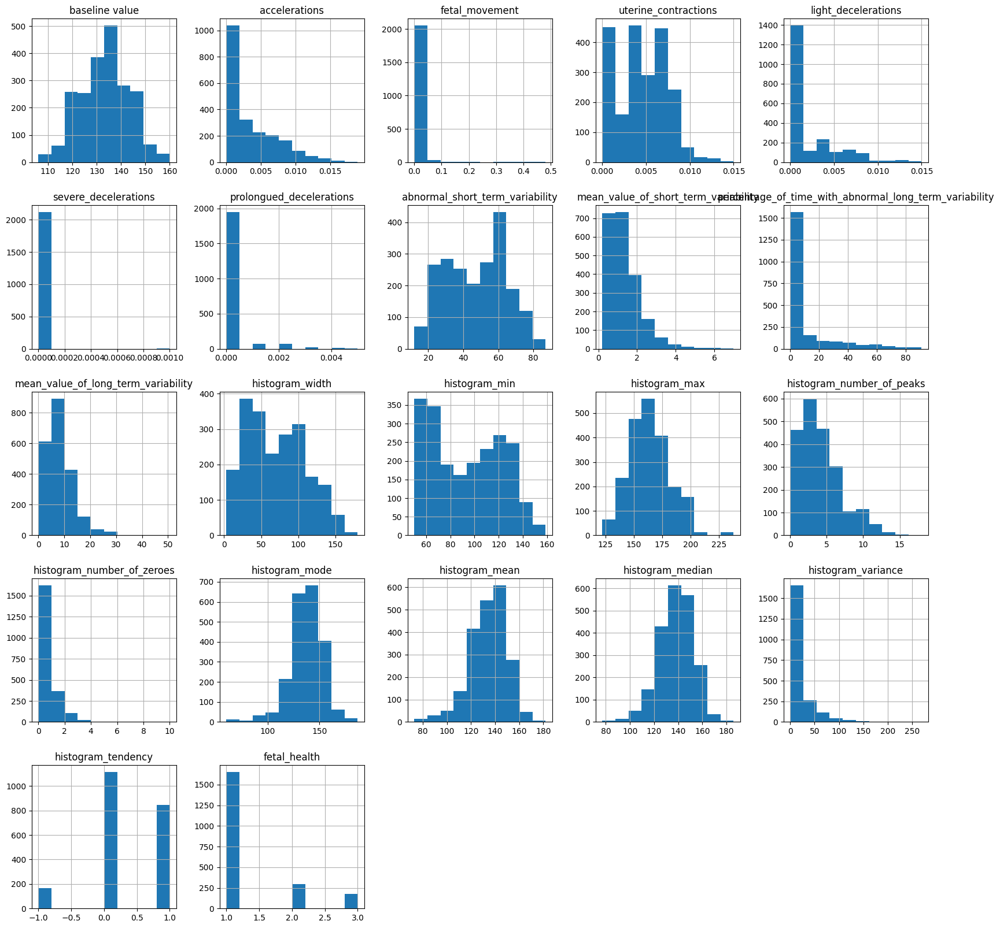

In [28]:
# Plotting the distribution of the fetal health data
data.hist(figsize=(20,20));

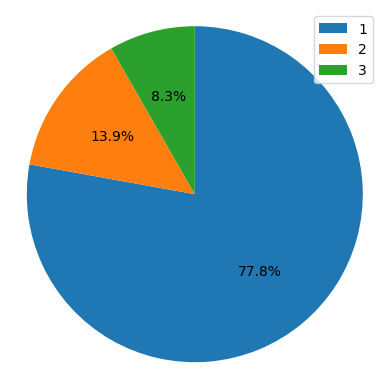

In [29]:
# Proportion of fetal health classes
plt.pie(data['fetal_health'].value_counts(), startangle = 90, counterclock = False, autopct='%1.1f%%',);
plt.axis('square')
plt.legend(['1','2','3']);

#### Bivariate Analysis

The following features were found to be relatively more correlated to the target than the rest:

- prolongued_decelerations
- abnormal_short_term_variability
- percentage_of_time_with_abnormal_long_term_variability
- accelerations


<AxesSubplot: >

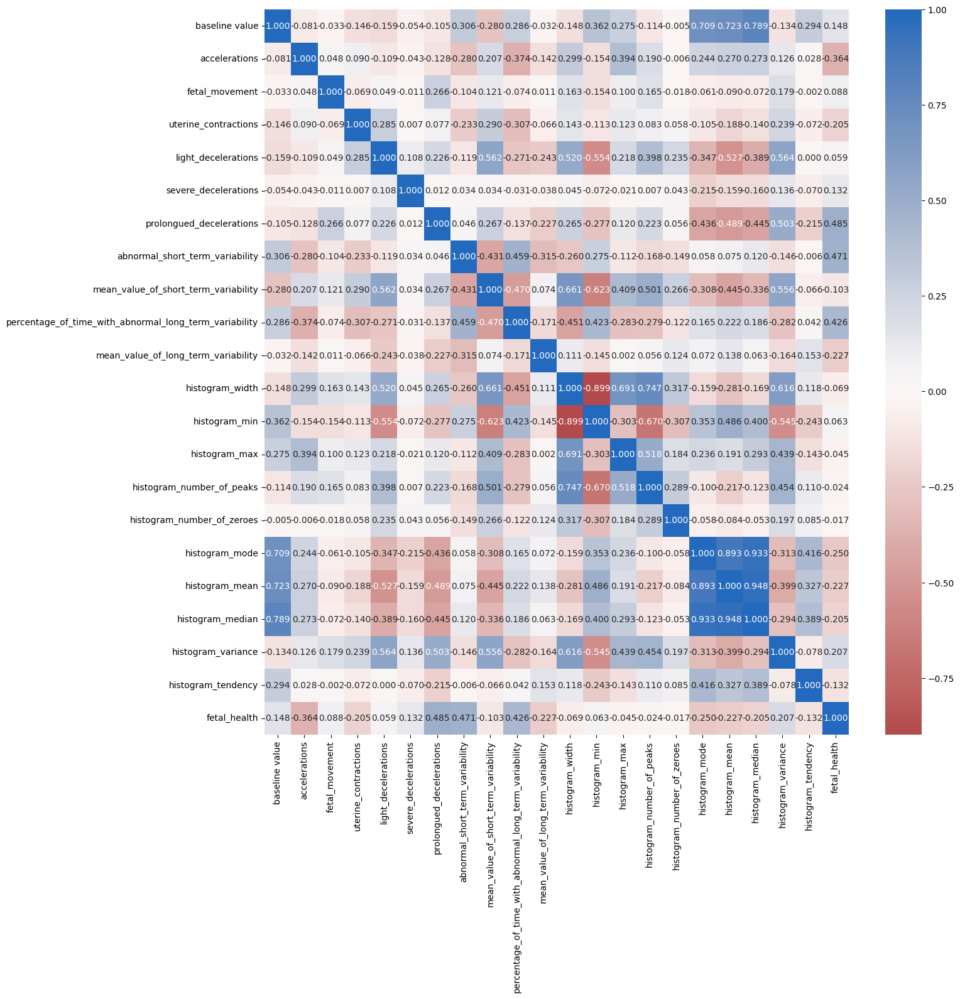

In [33]:
#plot a heat map to show us the correlation of the data
plt.figure(figsize = [15, 15])
sns.heatmap(data.corr(method = 'pearson'), annot = True, fmt = '.3f', cmap = 'vlag_r', center = 0)

### Comparing the different variables with fetal_health

### The below boxplot shows that the median value of 'prolongued_decelerations' is higher for the 'Pathological'(3.0) class compared to the other two classes

<AxesSubplot: xlabel='fetal_health', ylabel='prolongued_decelerations'>

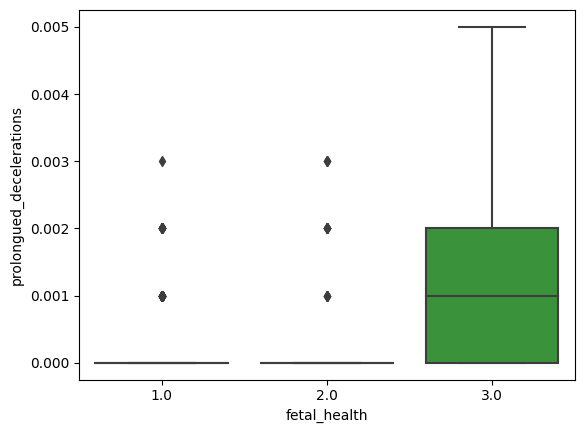

In [54]:
##Prolonged Deceleration and Fetal_health
sns.boxplot(data = data, x = 'fetal_health', y = 'prolongued_decelerations')

### The boxplot below shows that the normal(1.0) has a more coverage compared to 2.0 and 3

<AxesSubplot: xlabel='fetal_health', ylabel='abnormal_short_term_variability'>

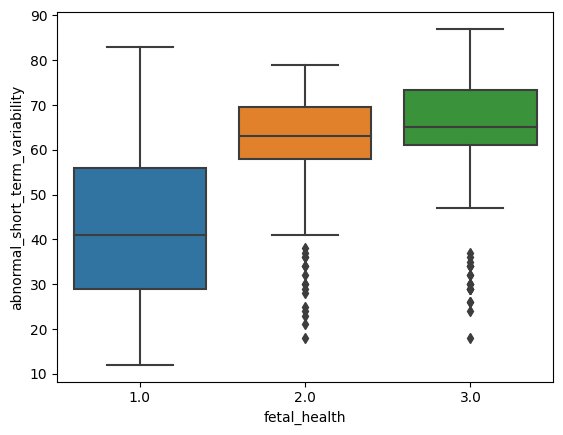

In [56]:
## Abnormal Short Term Variability and Fetal Health
sns.boxplot(data = data, x = 'fetal_health', y = 'abnormal_short_term_variability')

<AxesSubplot: xlabel='fetal_health', ylabel='abnormal_short_term_variability'>

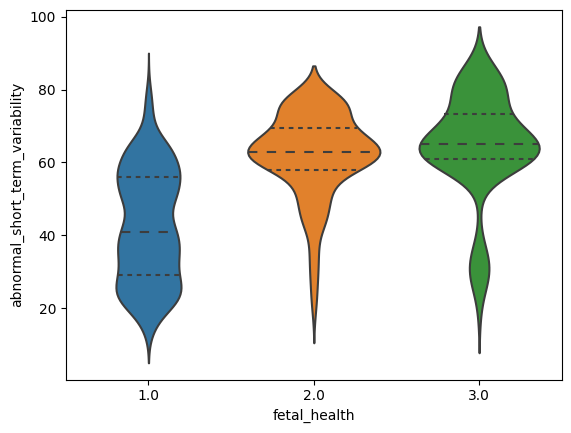

In [38]:
sns.violinplot(data = data, x = 'fetal_health', y = 'abnormal_short_term_variability', inner = 'quartile')

<AxesSubplot: xlabel='fetal_health', ylabel='percentage_of_time_with_abnormal_long_term_variability'>

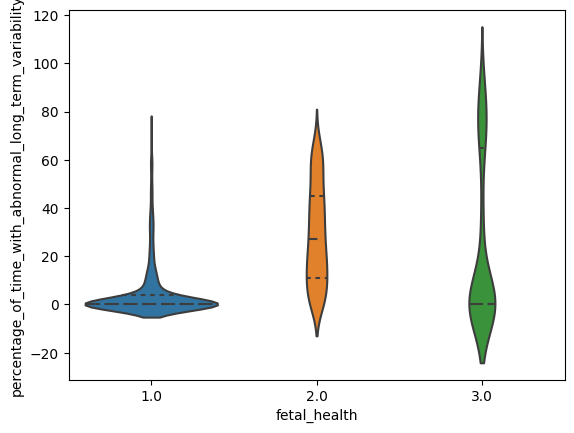

In [39]:
sns.violinplot(data = data, x = 'fetal_health', y = 'percentage_of_time_with_abnormal_long_term_variability', inner = 'quartile')

#### Multivariate Analysis
The identified correlated features were then observed in pairs in relation to the target feature as the third entity.

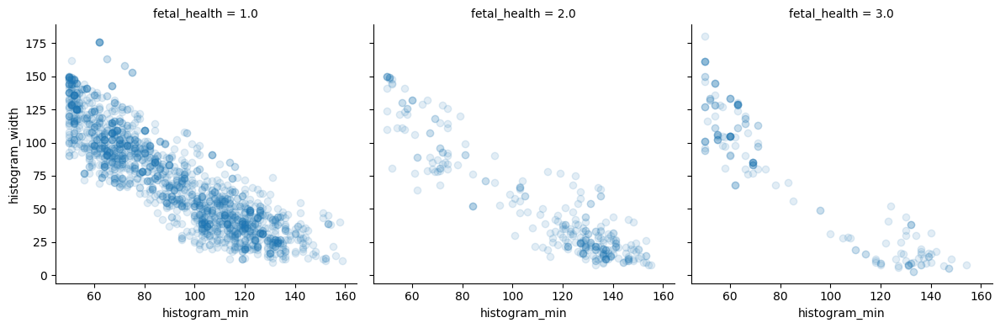

In [40]:
# Plot 1: Plotting the homework study time vs. the total score based on the number of cellphones

g = sns.FacetGrid(data = data, col = 'fetal_health', height = 4)
g.map(plt.scatter, 'histogram_min', 'histogram_width', alpha = 1/8);

### Data Cleaning
### At this point. the categorical data was converted to categorical values

In [57]:
data.fetal_health.unique()

array([2., 1., 3.])

### Task 2

#### Pandas Profiling

In [41]:
# Creating the pandas_profiling report for Fetal Health Data named profile
profile = ProfileReport(data, title="Fetal Health Data Pandas Profiling Report", explorative = True)

In [42]:
# As the pdf export is not supported, the pandas_profiling report will be saved as an html
profile.to_file("Fetal_Health_Data_report.html")

Export report to file: 100%|██████████| 1/1 [00:00<00:00, 10.60it/s]


In [45]:
profile.to_notebook_iframe()

### Task 3

<AxesSubplot: >

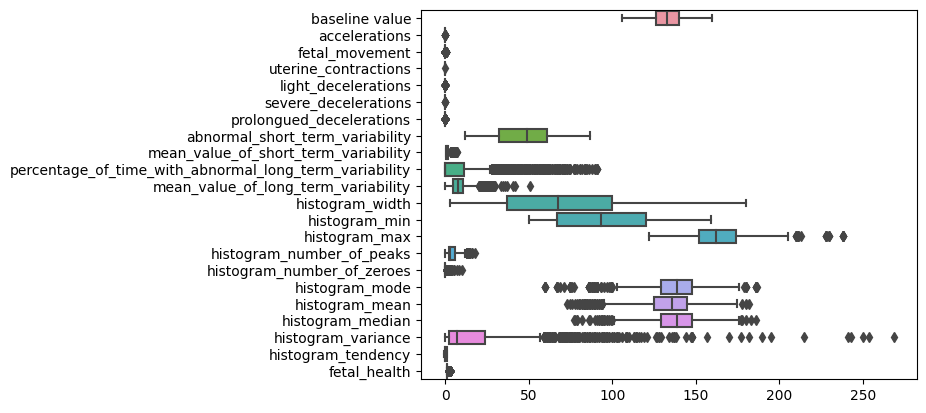

In [46]:
sns.boxplot(data = data, orient = 'h')

In [48]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

X = data.drop(['fetal_health'], axis = 1)
y = data['fetal_health']

scaled_X = scaler.fit_transform(X)

<AxesSubplot: >

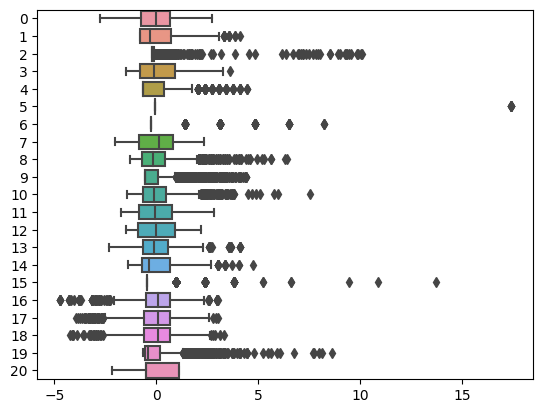

In [49]:
sns.boxplot(data = scaled_X, orient = 'h')

### Task 4

('LR', 0.8909694270345684, 0.010647404589051291)
('LDA', 0.8756974694620727, 0.013388503471500857)
('KNN', 0.9024112370714782, 0.008835453301130565)
('CART', 0.9299474953336727, 0.016765827166506788)
('NB', 0.7645962669669374, 0.03816711901066739)
('SVM', 0.910737722645837, 0.015013837523231426)
('RF', 0.9433118919823293, 0.013827376605084669)
('GB', 0.9521947514625875, 0.010846106235247269)
('ADA', 0.8951453235701876, 0.01726337162036237)


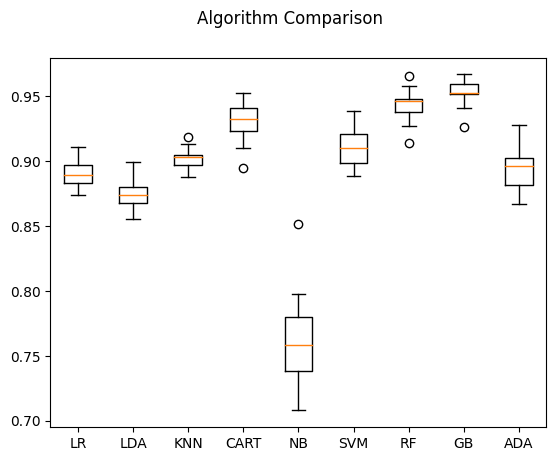

In [50]:
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier


# Prepare models and add them to a list
models = []
models.append(('LR', LogisticRegression(max_iter=1000)))
models.append(('LDA', LinearDiscriminantAnalysis()))
models.append(('KNN', KNeighborsClassifier()))
models.append(('CART', DecisionTreeClassifier()))
models.append(('NB', GaussianNB()))
models.append(('SVM', SVC()))
models.append(('RF', RandomForestClassifier()))
models.append(('GB', GradientBoostingClassifier()))
models.append(('ADA', AdaBoostClassifier()))

# Evaluate each model in turn
results = []
names = []
scoring = 'f1_weighted'

for name, model in models:
    skfold = StratifiedKFold(n_splits=10, random_state=7, shuffle=True)
    cv_results = cross_val_score(model, scaled_X, y, cv=skfold, scoring=scoring)
    results.append(cv_results)
    names.append(name)
    msg = (name, cv_results.mean(), cv_results.std())
    print(msg)

# Boxplot algorithm comparison
fig = plt.figure()
fig.suptitle('Algorithm Comparison')
ax = fig.add_subplot(111)
plt.boxplot(results)
ax.set_xticklabels(names)
plt.show()